Installing lib

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import shapely.geometry as sh
import math
from geopy.geocoders import Nominatim
import time
from matplotlib import ticker
import cufflinks as cf
#import chart studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly import __version__
import plotly.offline as pyof
import geopandas as gpd
import plotly.express as px
#import plotly.plotly as pypy


In [ ]:
cf.go_offline()

In [ ]:
init_notebook_mode(connected=True)

In [ ]:
%matplotlib inline

Pulling source

In [ ]:
house_pre_src = pd.read_csv('House Price India.csv')

Performing numpy operation

finding the count of data

In [ ]:
print("Data shape:", house_pre_src.shape)  # Number of rows and columns
print("Number of houses:", house_pre_src.shape[0])

Data shape: (14619, 23)
Number of houses: 14619


In [ ]:
house_pre_src.describe()

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Built Year,Renovation Year,Postal Code,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price
count,1.461900e+04,14619.000000,14619.000000,14619.000000,14619.000000,1.461900e+04,14619.000000,14619.000000,14619.000000,14619.000000,...,14619.000000,14619.000000,14619.000000,14619.000000,14619.000000,14619.000000,14619.000000,14619.000000,14619.000000,1.461900e+04
mean,6.762821e+09,42604.546412,3.379233,2.129557,2098.156851,1.509369e+04,1.502326,0.007661,0.232848,3.430399,...,1970.929817,90.930228,122033.064300,52.792843,-114.403996,1996.641836,12754.003078,2.012244,64.951433,5.388063e+05
std,6.237162e+03,67.343747,0.938655,0.769955,928.218740,3.792089e+04,0.540241,0.087196,0.765651,0.664047,...,29.491743,416.230218,19.081451,0.137525,0.141325,691.078387,26059.234785,0.817312,8.936129,3.672294e+05
min,6.762810e+09,42491.000000,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,...,1900.000000,0.000000,122003.000000,52.385900,-114.709000,460.000000,651.000000,1.000000,50.000000,7.800000e+04
25%,6.762815e+09,42546.000000,3.000000,1.750000,1440.000000,5.010500e+03,1.000000,0.000000,0.000000,3.000000,...,1951.000000,0.000000,122017.000000,52.707600,-114.519000,1490.000000,5097.500000,1.000000,57.000000,3.200000e+05
50%,6.762821e+09,42600.000000,3.000000,2.250000,1930.000000,7.620000e+03,1.500000,0.000000,0.000000,3.000000,...,1975.000000,0.000000,122032.000000,52.806400,-114.421000,1850.000000,7620.000000,2.000000,65.000000,4.500000e+05
75%,6.762826e+09,42662.000000,4.000000,2.500000,2570.000000,1.080000e+04,2.000000,0.000000,0.000000,4.000000,...,1997.000000,0.000000,122048.000000,52.908900,-114.315000,2380.000000,10125.000000,3.000000,73.000000,6.450000e+05
max,6.762832e+09,42734.000000,33.000000,8.000000,13540.000000,1.074218e+06,3.500000,1.000000,4.000000,5.000000,...,2015.000000,2015.000000,122072.000000,53.007600,-113.505000,6110.000000,560617.000000,3.000000,80.000000,7.700000e+06


Rounding off bedroom,bathroom and floor

In [ ]:
house_pre_src['number of bathrooms'] = house_pre_src['number of bathrooms'].apply(math.ceil)
house_pre_src['number of bedrooms'] = house_pre_src['number of bedrooms'].apply(math.ceil)
house_pre_src['number of floors'] = house_pre_src['number of floors'].apply(math.ceil)

In [ ]:
house_pre_src

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Built Year,Renovation Year,Postal Code,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price
0,6762810635,42491,4,3,2920,4000,2,0,0,5,...,1909,0,122004,52.8878,-114.470,2470,4000,2,51,1400000
1,6762810998,42491,5,3,2910,9480,2,0,0,3,...,1939,0,122004,52.8852,-114.468,2940,6600,1,53,1200000
2,6762812605,42491,4,3,3310,42998,2,0,0,3,...,2001,0,122005,52.9532,-114.321,3350,42847,3,76,838000
3,6762812919,42491,3,2,2710,4500,2,0,0,4,...,1929,0,122006,52.9047,-114.485,2060,4500,1,51,805000
4,6762813105,42491,3,3,2600,4750,1,0,0,4,...,1951,0,122007,52.9133,-114.590,2380,4750,1,67,790000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14614,6762830250,42734,2,2,1556,20000,1,0,0,4,...,1957,0,122066,52.6191,-114.472,2250,17286,3,76,221700
14615,6762830339,42734,3,2,1680,7000,2,0,0,4,...,1968,0,122072,52.5075,-114.393,1540,7480,3,59,219200
14616,6762830618,42734,2,1,1070,6120,1,0,0,3,...,1962,0,122056,52.7289,-114.507,1130,6120,2,64,209000
14617,6762830709,42734,4,1,1030,6621,1,0,0,4,...,1955,0,122042,52.7157,-114.411,1420,6631,3,54,205000


finding missing values per column

In [ ]:
missing_values = np.isnan(house_pre_src).sum(axis=0)
print("Missing values per column:", missing_values)

Missing values per column: id                                       0
Date                                     0
number of bedrooms                       0
number of bathrooms                      0
living area                              0
lot area                                 0
number of floors                         0
waterfront present                       0
number of views                          0
condition of the house                   0
grade of the house                       0
Area of the house(excluding basement)    0
Area of the basement                     0
Built Year                               0
Renovation Year                          0
Postal Code                              0
Lattitude                                0
Longitude                                0
living_area_renov                        0
lot_area_renov                           0
Number of schools nearby                 0
Distance from the airport                0
Price                      

Calculating simple Min,Max,Mean,SD per column(23 columns)

In [ ]:
stats = np.nanmin(house_pre_src), np.nanmax(house_pre_src), np.nanmean(house_pre_src), np.nanstd(house_pre_src)
print("Minimum, Maximum, Mean, Standard Deviation per column:", stats)

Minimum, Maximum, Mean, Standard Deviation per column: (-114.709, 6762831616.0, 294067843.5545985, 1379142777.519149)


Using matplotlib for plotting

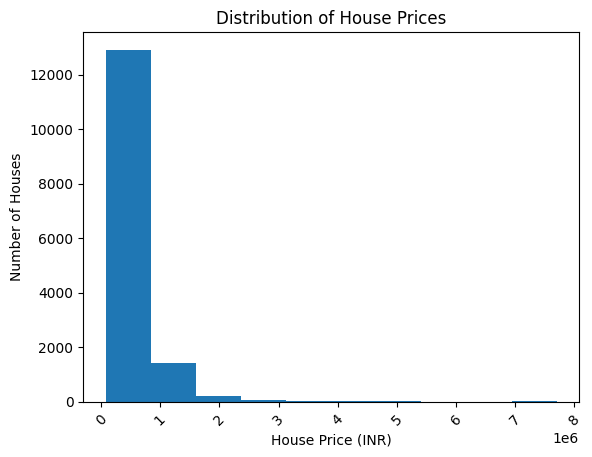

In [ ]:
house_pre_src = np.loadtxt("House Price India.csv", delimiter=",", skiprows=1)
plt.hist(house_pre_src[:, -1])
plt.xlabel("House Price (INR)")
plt.ylabel("Number of Houses")
plt.xticks(rotation=45)
plt.title("Distribution of House Prices")
plt.show()

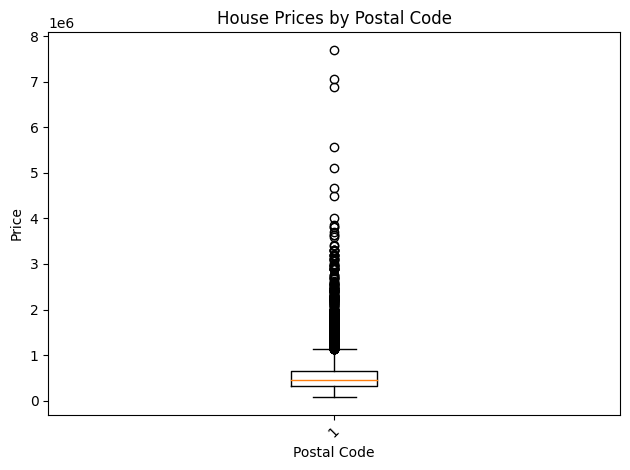

In [ ]:
house_pre_src = pd.read_csv('House Price India.csv')

# Use the "Price" column for bar heights
#plt.bar(x=house_pre_src['Postal Code'], y=house_pre_src['Price'], width=100,height=100)  # Adjust width as needed
plt.boxplot(x='Price',data=house_pre_src)
plt.xlabel("Postal Code")
plt.ylabel("Price")
plt.title("House Prices by Postal Code")
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust spacing between elements

plt.show()

Finding the area with respect to pin-code

In [ ]:
def get_area_from_postal_code(postal_code):
    # Replace the dictionary with your actual mapping of postal codes to areas
    postal_code_map = {
        122003: "Civil Lines",
122004: "Sector_18",
122005: "Sector_22",
122006: "Sector_23",
122007: "Sector_40",
122008: "DLF_Phase_1",
122009: "Sohna_Road",
122010: "Sector_56",
122011: "Sector_62",
122012: "Sector_63",
122013: "Palam_Vihar",
122014: "Sector_29",
122015: "Sector_44",
122016: "Sector_45",
122017: "Sector_50",
122018: "Sector_57",
122019: "Sector_43",
122020: "Sector_15",
122021: "Sector_14",
122022: "Sector_37",
122023: "Sector_32",
122024: "Sector_39",
122025: "Sector_46",
122026: "Sector_47",
122027: "Sector_48",
122028: "Sector_49",
122029: "Sector_60",
122030: "Sector_61",
122031: "Sector_33",
122032: "Sector_34",
122033: "Sector_35",
122034: "Sector_36",
122035: "Sector_51",
122036: "Sector_52",
122037: "Sector_53",
122038: "Sector_54",
122039: "Sector_55",
122040: "Sector_66",
122041: "Sector_65",
122042: "Sector_67",
122043: "Sector_68",
122044: "Sector_69",
122045: "Sector_70",
122046: "Sector_71",
122047: "Sector_72",
122048: "Sector_73",
122049: "Sector_74",
122050: "Sector_75",
122051: "Sector_76",
122052: "Sector_77",
122053: "Sector_78",
122054: "Sector_79",
122055: "Sector_80",
122056: "Sector_81",
122057: "Sector_82",
122058: "Sector_83",
122059: "Sector_84",
122060: "Sector_85",
122061: "Sector_86",
122062: "Sector_87",
122063: "Sector_88",
122064: "Sector_89",
122065: "Sector_90",
122066: "Sector_91",
122067: "Sector_92",
122068: "Sector_93",
122069: "Sector_94",
122070: "Sector_95",
122071: "Sector_96",
122072: "Sector_97"
    }
    return postal_code_map.get(postal_code, "Unknown")

house_pre_src['Area'] = house_pre_src['Postal Code'].apply(get_area_from_postal_code)

Using Scatterplot to find the price rise with respect to area

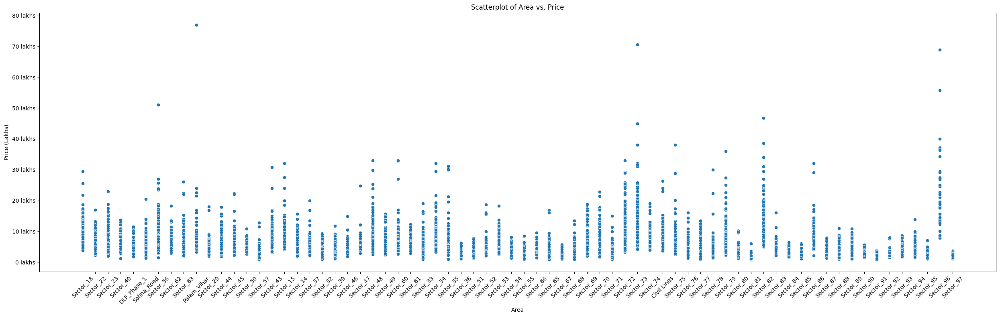

In [ ]:
plt.figure(figsize=(25, 8))
sns.scatterplot(data=house_pre_src, x='Area', y='Price')

# Define the lakh_formatter function
def lakh_formatter(value, pos):
    return f"{value / 100000:.0f} lakhs"

plt.xticks(rotation=45)  # Rotate x-axis labels
plt.xlabel('Area')

# Format y-axis labels in lakhs
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(lakh_formatter))
plt.ylabel('Price (Lakhs)')

plt.title('Scatterplot of Area vs. Price')
plt.tight_layout()

plt.show()

Using Barplot to find the price rise with respect to area

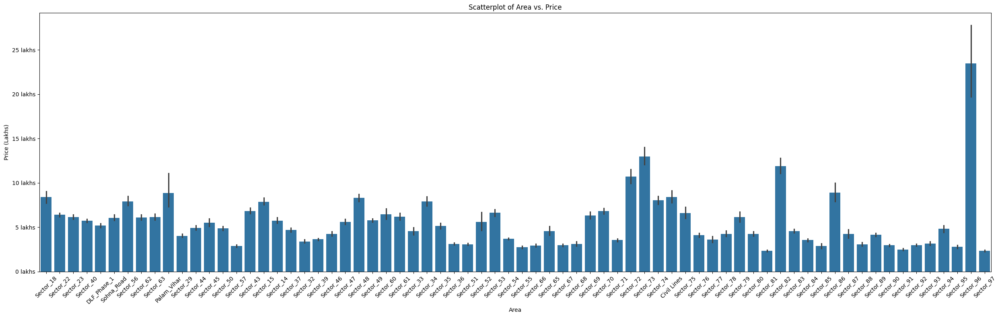

In [ ]:
plt.figure(figsize=(25, 8))
sns.barplot(data=house_pre_src, x='Area', y='Price')

# Define the lakh_formatter function
def lakh_formatter(value, pos):
    return f"{value / 100000:.0f} lakhs"

plt.xticks(rotation=45)  # Rotate x-axis labels
plt.xlabel('Area')

# Format y-axis labels in lakhs
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(lakh_formatter))
plt.ylabel('Price (Lakhs)')

plt.title('Scatterplot of Area vs. Price')
plt.tight_layout()

plt.show()


Using Areaplot to find the price rise with respect to area

<Figure size 10000x800 with 0 Axes>

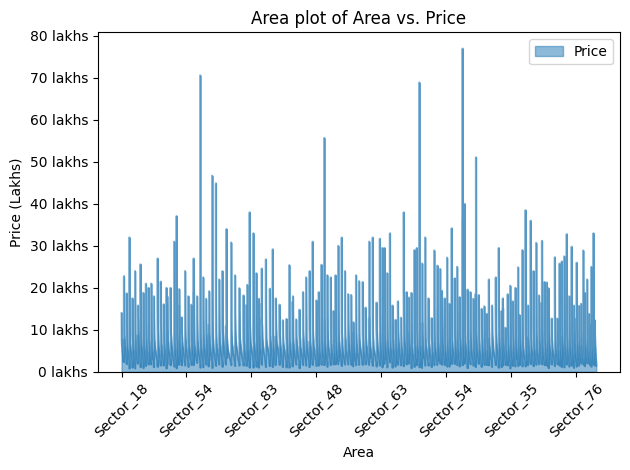

In [ ]:
plt.figure(figsize=(100, 8))
house_pre_src.plot.area(x='Area',y='Price',alpha=0.5)
plt.xticks(rotation=45)  # Rotate x-axis labels
plt.xlabel('Area')
plt.ylabel('Price (Lakhs)')
plt.title('Area vs. Price')
def lakh_formatter(value, pos):
    return f"{value / 100000:.0f} lakhs"

plt.xticks(rotation=45)  # Rotate x-axis labels
plt.xlabel('Area')

# Format y-axis labels in lakhs
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(lakh_formatter))
plt.ylabel('Price (Lakhs)')

plt.title('Area plot of Area vs. Price')
plt.tight_layout()

plt.show()


Analyzing using Plotly and Cufflinks


In [ ]:
%matplotlib inline

In [ ]:
house_pre_src.iplot(x='Area',y='Price',kind='line',title='Area vs Price')

In [ ]:
house_pre_src.iplot(x='Area',y='Price',kind='bar',title='Area vs Price')

In [ ]:
house_pre_src.iplot(x='Area',y='Price',kind='hist',title='Area vs Price')

Machine learning session

In [ ]:
pip install scikit-learn

Linear regression

Linear regression is a statistical method used to model the relationship between a dependent variable and one or more independent variables. It assumes a linear relationship between these variables and fits a straight line or plane to the data points.

Key concepts:

Dependent variable: The variable you want to predict (e.g., house price).
Independent variables: The variables used to predict the dependent variable (e.g., size, number of bedrooms).
Linear relationship: The assumption that the relationship between the variables can be represented by a linear equation.
Least squares: The method used to find the best-fit line that minimizes the sum of the squared errors between the predicted and actual values.


In [ ]:
house_pre_src['number of bathrooms'] = house_pre_src['number of bathrooms'].apply(math.ceil)
house_pre_src['number of bedrooms'] = house_pre_src['number of bedrooms'].apply(math.ceil)
house_pre_src['number of floors'] = house_pre_src['number of floors'].apply(math.ceil)

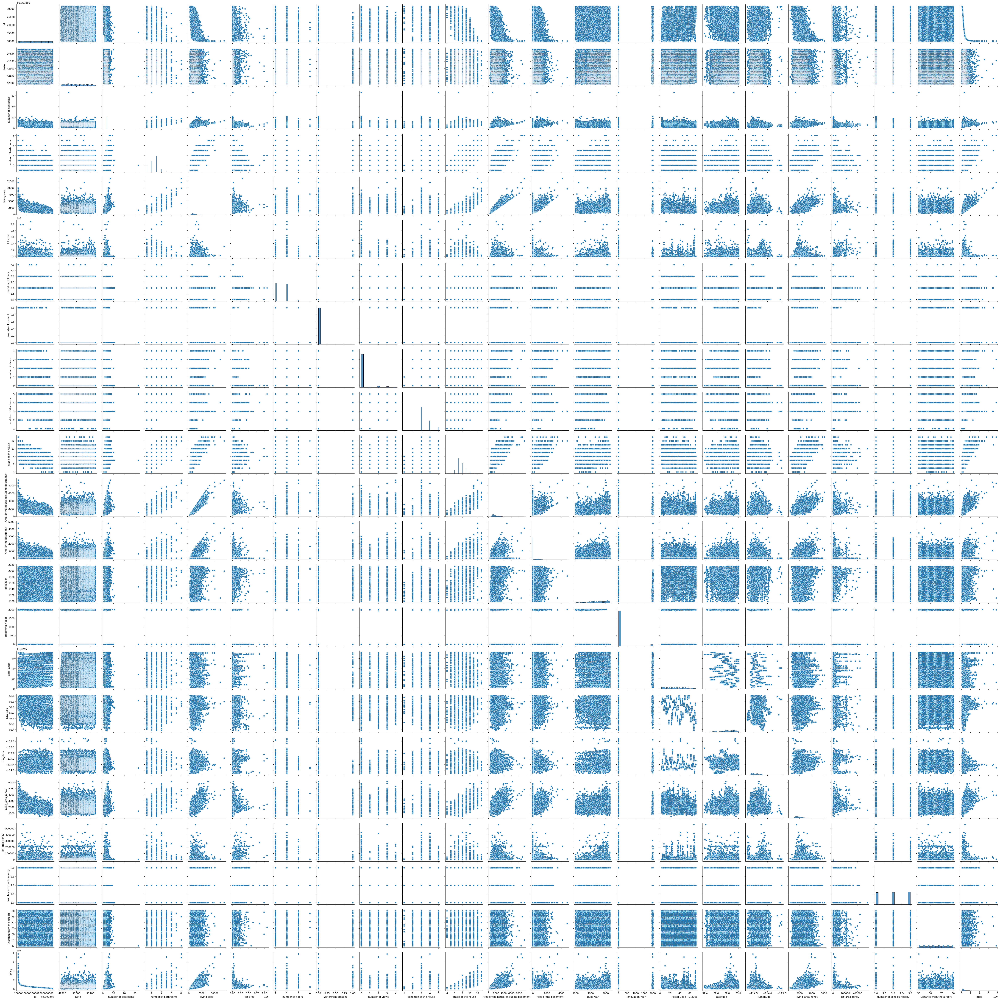

In [ ]:
sns.pairplot(house_pre_src)

<ipython-input-26-740c092e0de9>:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




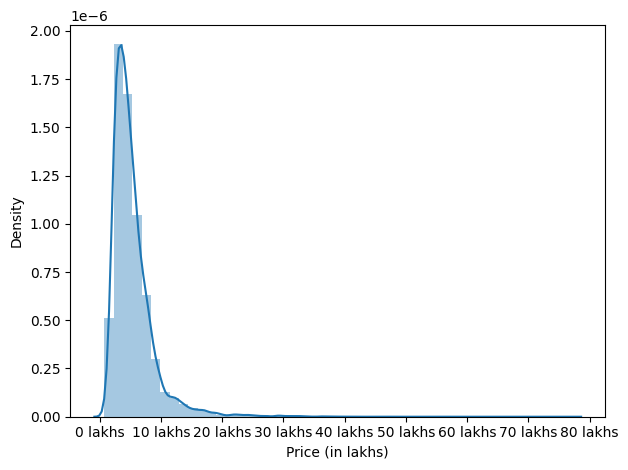

In [ ]:
sns.distplot(house_pre_src['Price'])
# Setting the y-axis label and formatter
plt.xlabel('Price (in lakhs)')
plt.gca().xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f"{x / 1e5:.0f} lakhs"))
plt.tight_layout()
plt.show()

In [ ]:
house_pre_src.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14619 entries, 0 to 14618
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   id                                     14619 non-null  int64  
 1   Date                                   14619 non-null  int64  
 2   number of bedrooms                     14619 non-null  int64  
 3   number of bathrooms                    14619 non-null  int64  
 4   living area                            14619 non-null  int64  
 5   lot area                               14619 non-null  int64  
 6   number of floors                       14619 non-null  int64  
 7   waterfront present                     14619 non-null  int64  
 8   number of views                        14619 non-null  int64  
 9   condition of the house                 14619 non-null  int64  
 10  grade of the house                     14619 non-null  int64  
 11  Ar

In [ ]:
house_pre_src.columns

Index(['id', 'Date', 'number of bedrooms', 'number of bathrooms',
       'living area', 'lot area', 'number of floors', 'waterfront present',
       'number of views', 'condition of the house', 'grade of the house',
       'Area of the house(excluding basement)', 'Area of the basement',
       'Built Year', 'Renovation Year', 'Postal Code', 'Lattitude',
       'Longitude', 'living_area_renov', 'lot_area_renov',
       'Number of schools nearby', 'Distance from the airport', 'Price',
       'Area'],
      dtype='object')

Spliting the data where X is the feature and Y is the predicition

In [ ]:
X=house_pre_src[['number of bedrooms', 'number of bathrooms', 'number of floors','living area','number of views','Area of the house(excluding basement)']]
y=house_pre_src['Price']

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

In [ ]:
from sklearn.linear_model import LinearRegression

creating an linear product

In [ ]:
lm=LinearRegression()

In [ ]:
lm.fit(X_train,y_train)

LinearRegression()

In [ ]:
print(lm.intercept_)

40963.24836070894


In [ ]:
lm.coef_

array([-3.49771924e+04, -7.61795899e+03,  4.42270769e+04,  2.71508441e+02,
        9.10496004e+04, -1.49137890e+01])

In [ ]:
X_train.columns

Index(['number of bedrooms', 'number of bathrooms', 'number of floors',
       'living area', 'number of views',
       'Area of the house(excluding basement)'],
      dtype='object')

In [ ]:
coeff_df= pd.DataFrame(lm.coef_,X_train.columns,columns=['Coeff'])

In [ ]:
coeff_df

#for example- for 1 unit increase (ex: number of bathrooms) the rate increase to 9329

,Coeff
number of bedrooms,-34977.192362
number of bathrooms,-7617.958990
number of floors,44227.076907
living area,271.508441
number of views,91049.600377
Area of the house(excluding basement),-14.913789


Predictions

In [ ]:
predictions=lm.predict(X_test) #done with things which are not done before

In [ ]:
predictions

array([ 449566.76926876,  378963.86948704,  325201.4021272 , ...,
        640370.97097257, 1362585.04064134, 1004917.03796228])

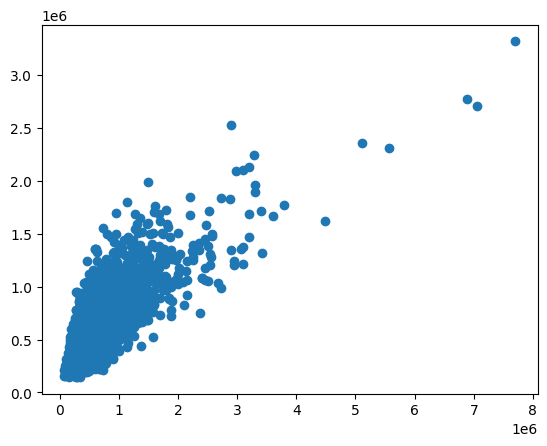

In [ ]:
plt.scatter(y_test,predictions)

<ipython-input-43-6c26bcc0c6bf>:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




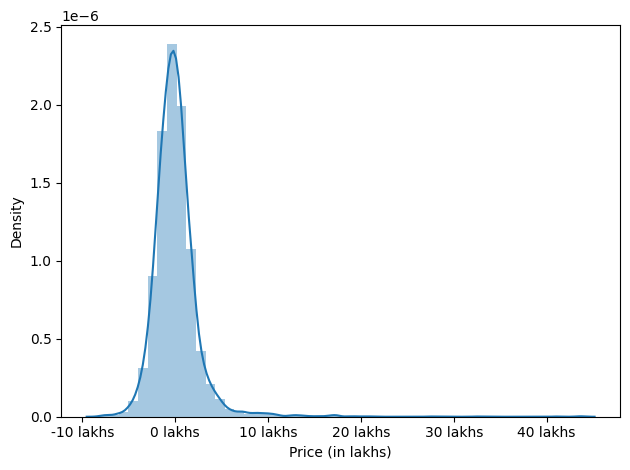

In [ ]:
sns.distplot((y_test-predictions))
plt.xlabel('Price (in lakhs)')
plt.gca().xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f"{x / 1e5:.0f} lakhs"))
plt.tight_layout()
plt.show()

In [ ]:
from sklearn import metrics

MAE:

Calculates the average absolute difference between predicted and actual values.
Less sensitive to outliers than MSE and RMSE.
Formula: MAE = 1/n * Σ|yi - ŷi| where yi is the actual value, ŷi is the predicted value, and n is the number of data points.

In [ ]:
metrics.mean_absolute_error(y_test,predictions)

157836.94228980952

MSE:

Calculates the average squared difference between predicted and actual values.
More sensitive to outliers than MAE due to squaring the errors.
Formula: MSE = 1/n * Σ(yi - ŷi)²

In [ ]:
metrics.mean_squared_error(y_test,predictions)

66903161103.53667

RMSE:

The square root of MSE.
Provides a more interpretable measure of error as it has the same units as the target variable.
Formula: RMSE = √(1/n * Σ(yi - ŷi)²)

In [ ]:
np.sqrt(metrics.mean_squared_error(y_test,predictions))


258656.45382154427

**Bias Variance Trade Off:**

The bias-variance trade-off is a fundamental concept in machine learning that explores the relationship between a model's ability to fit the training data (bias) and its ability to generalize to new, unseen data (variance).

**Bias**:

Refers to a model's tendency to underfit the training data.
A high-bias model is too simple and cannot capture the underlying patterns in the data.
This leads to poor performance on both the training and testing sets.

**Variance**:

Refers to a model's sensitivity to small changes in the training data.
A high-variance model is too complex and overfits the training data, leading to poor generalization performance on new data.

**Trade-off**:

The goal is to find a balance between bias and variance.
A model with low bias and low variance is ideal, as it can accurately fit the training data while also generalizing well to new data.
However, achieving this balance is often challenging.
Strategies for addressing the bias-variance trade-off:

**Regularization**: Adding a penalty term to the loss function can help reduce overfitting and improve generalization.
Model complexity: Adjusting the complexity of the model (e.g., number of features, layers in a neural network) can help find the right balance.
Ensemble methods: Combining multiple models can help reduce variance and improve generalization.

**Cross-validation**: Evaluating the model's performance on multiple training and testing sets can help identify the optimal level of complexity.

**Understanding the trade-off:**

A model with high bias and low variance is underfitting, meaning it is too simple to capture the underlying patterns in the data.
A model with low bias and high variance is overfitting, meaning it is too complex and fits the training data too closely, leading to poor generalization.
The ideal model is one that strikes a balance between bias and variance, providing good performance on both the training and testing sets.
By understanding the bias-variance trade-off and employing appropriate strategies, you can build machine learning models that generalize well to new data and achieve better performance.

Logistic Regression theory

Logistic Regression is a statistical method used to predict the probability of an event occurring. It's commonly used for classification problems where the outcome is binary (e.g., yes/no, 1/0).

How it works:

Transforms the output: Logistic regression transforms the predicted values into probabilities using a logistic function (also known as a sigmoid function). This ensures that the predicted probabilities fall between 0 and 1.
Threshold: A threshold value is set (e.g., 0.5). If the predicted probability is above the threshold, the event is predicted to occur. Otherwise, it's predicted not to occur.
Key points:

Non-linear relationship: While the model is called "linear," the relationship between the independent variables and the predicted probability is non-linear due to the logistic function.
Odds ratio: Logistic regression can provide odds ratios, which represent the change in the odds of an event occurring for a unit increase in an independent variable.
Applications: Logistic regression is widely used in various fields, including marketing, finance, medicine, and social sciences

To find out missing data

<Axes: >

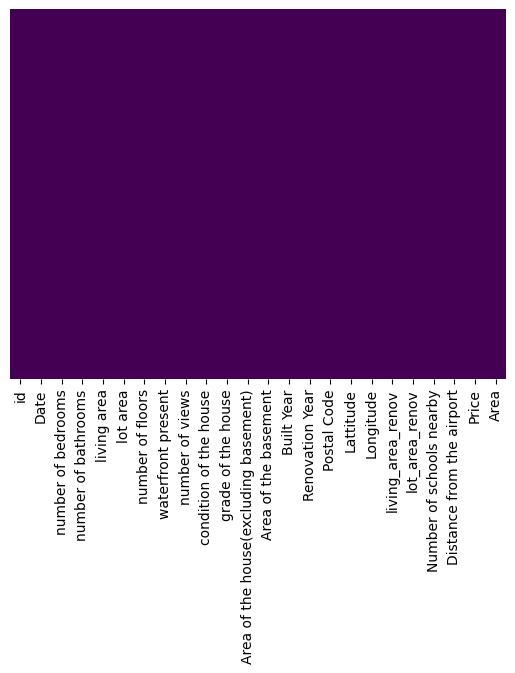

In [ ]:
sns.heatmap(house_pre_src.isnull(),yticklabels=False,cbar=False,cmap='viridis')
#To make sure whether there is any null value

<Axes: xlabel='number of bedrooms', ylabel='count'>

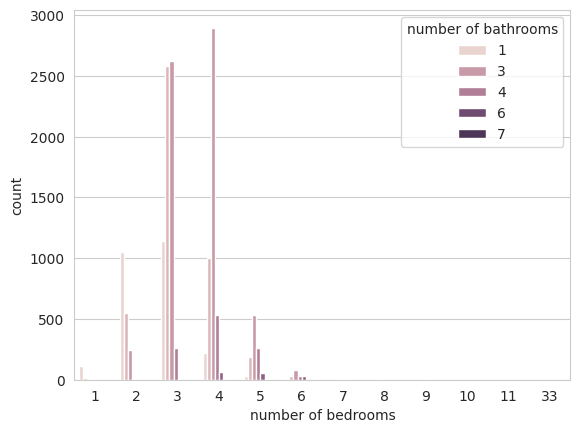

In [ ]:
sns.set_style('whitegrid')
sns.countplot(x='number of bedrooms',hue='number of bathrooms',data=house_pre_src)

<Axes: ylabel='Frequency'>

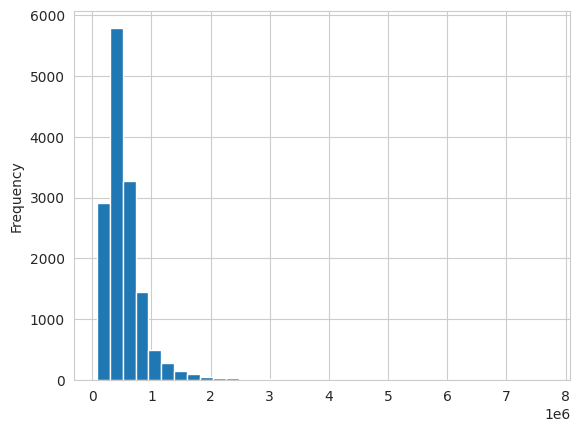

In [ ]:
house_pre_src['Price'].plot.hist(bins=35)

In [ ]:
house_pre_src

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Renovation Year,Postal Code,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price,Area
0,6762810635,42491,4,3,2920,4000,2,0,0,5,...,0,122004,52.8878,-114.470,2470,4000,2,51,1400000,Sector_18
1,6762810998,42491,5,3,2910,9480,2,0,0,3,...,0,122004,52.8852,-114.468,2940,6600,1,53,1200000,Sector_18
2,6762812605,42491,4,3,3310,42998,2,0,0,3,...,0,122005,52.9532,-114.321,3350,42847,3,76,838000,Sector_22
3,6762812919,42491,3,2,2710,4500,2,0,0,4,...,0,122006,52.9047,-114.485,2060,4500,1,51,805000,Sector_23
4,6762813105,42491,3,3,2600,4750,1,0,0,4,...,0,122007,52.9133,-114.590,2380,4750,1,67,790000,Sector_40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14614,6762830250,42734,2,2,1556,20000,1,0,0,4,...,0,122066,52.6191,-114.472,2250,17286,3,76,221700,Sector_91
14615,6762830339,42734,3,2,1680,7000,2,0,0,4,...,0,122072,52.5075,-114.393,1540,7480,3,59,219200,Sector_97
14616,6762830618,42734,2,1,1070,6120,1,0,0,3,...,0,122056,52.7289,-114.507,1130,6120,2,64,209000,Sector_81
14617,6762830709,42734,4,1,1030,6621,1,0,0,4,...,0,122042,52.7157,-114.411,1420,6631,3,54,205000,Sector_67


In [ ]:
house_pre_src['number of bathrooms'] = house_pre_src['number of bathrooms'].apply(math.ceil)
house_pre_src['number of bedrooms'] = house_pre_src['number of bedrooms'].apply(math.ceil)
house_pre_src['number of floors'] = house_pre_src['number of floors'].apply(math.ceil)
# house_pre_src['waterfront present'] = house_pre_src['waterfront present'].replace(0, 1)
# house_pre_src['number of views'] = house_pre_src['number of views'].replace(0, 1)
# house_pre_src['Area of the basement'] = house_pre_src['Area of the basement'].replace(0, 1)
# house_pre_src['Renovation Year'] = house_pre_src['Renovation Year'].replace(0, 1)


In [ ]:
house_pre_src_log = house_pre_src.copy()

In [ ]:
X = house_pre_src_log.drop('Area',axis=1)
y = house_pre_src_log['number of bedrooms']

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
logmodel = LogisticRegression()

In [ ]:
logmodel = LogisticRegression(max_iter=1000)


In [ ]:
logmodel.fit(X_train,y_train)

LogisticRegression(max_iter=1000)

In [ ]:
predictions = logmodel.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report

In [ ]:
print(classification_report(y_test,predictions))

              precision    recall  f1-score   support

           1       0.00      0.00      0.00        49
           2       0.00      0.00      0.00       703
           3       0.50      0.87      0.64      2656
           4       0.50      0.33      0.40      1892
           5       0.00      0.00      0.00       465
           6       0.00      0.00      0.00        70
           7       0.00      0.00      0.00         5
           8       0.00      0.00      0.00         5
           9       0.00      0.00      0.00         1
          10       0.00      0.00      0.00         1
          11       0.00      0.00      0.00         1

    accuracy                           0.50      5848
   macro avg       0.09      0.11      0.09      5848
weighted avg       0.39      0.50      0.42      5848



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
confusion_matrix(y_test,predictions)

array([[   0,    0,   49,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,  654,   49,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0, 2304,  352,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0, 1263,  629,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,  263,  202,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,   41,   29,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    2,    3,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    2,    3,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    1,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    1,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    1,    0,    0,    0,    0,    0,    0,    0,    0]])

K Nearest Neighbour

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler()

In [ ]:
scaler.fit(house_pre_src.drop('Area',axis=1))

StandardScaler()

In [ ]:
scaled_features = scaler.transform(house_pre_src.drop('Area',axis=1))

In [ ]:
df_feat= pd.DataFrame(scaled_features,columns=house_pre_src.columns[:-1])

In [ ]:
df_feat.head()

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Built Year,Renovation Year,Postal Code,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price
0,-1.634815,-1.68613,0.661360,0.588113,0.885428,-0.292558,0.790253,-0.087866,-0.304128,2.363771,...,-2.099975,-0.218469,-1.523222,0.690494,-0.467051,0.684979,-0.335939,-0.014982,-1.561292,2.345192
1,-1.576613,-1.68613,1.726750,0.588113,0.874655,-0.148042,0.790253,-0.087866,-0.304128,-0.648167,...,-1.082707,-0.218469,-1.523222,0.671588,-0.452898,1.365099,-0.236162,-1.238547,-1.337474,1.800554
2,-1.318955,-1.68613,0.661360,0.588113,1.305602,0.735881,0.790253,-0.087866,-0.304128,-0.648167,...,1.019648,-0.218469,-1.470814,1.166059,0.587292,1.958395,1.154832,1.208583,1.236435,0.814760
3,-1.268610,-1.68613,-0.404031,-0.495667,0.659181,-0.279373,0.790253,-0.087866,-0.304128,0.857802,...,-1.421796,-0.218469,-1.418405,0.813385,-0.573192,0.091683,-0.316751,-1.238547,-1.561292,0.724895
4,-1.238788,-1.68613,-0.404031,0.588113,0.540670,-0.272780,-0.971099,-0.087866,-0.304128,0.857802,...,-0.675799,-0.218469,-1.365996,0.875921,-1.316186,0.554744,-0.307157,-1.238547,0.229253,0.684047


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
# Check for missing values
print(df_feat.isnull().sum())

# Option 1: Drop rows with missing values (if applicable)
X = df_feat.dropna()
y = house_pre_src['number of bedrooms'].iloc[X.index]  # Select corresponding rows in y

# Option 2: Impute missing values (e.g., with mean or median)
X = df_feat.fillna(df_feat.mean())  # Replace missing values with means
y = house_pre_src['number of bedrooms']

# Now proceed with train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

id                                       0
Date                                     0
number of bedrooms                       0
number of bathrooms                      0
living area                              0
lot area                                 0
number of floors                         0
waterfront present                       0
number of views                          0
condition of the house                   0
grade of the house                       0
Area of the house(excluding basement)    0
Area of the basement                     0
Built Year                               0
Renovation Year                          0
Postal Code                              0
Lattitude                                0
Longitude                                0
living_area_renov                        0
lot_area_renov                           0
Number of schools nearby                 0
Distance from the airport                0
Price                                    0
dtype: int6

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
knn = KNeighborsClassifier(n_neighbors=1)

In [ ]:
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [ ]:
pred = knn.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

[[  10   37    2    0    0    0    0    0    0    0    0]
 [   8  508  181    6    0    0    0    0    0    0    0]
 [   0   91 2269  293    3    0    0    0    0    0    0]
 [   0    5  332 1470   85    0    0    0    0    0    0]
 [   0    0    3  245  203   14    0    0    0    0    0]
 [   0    0    1   11   40   17    1    0    0    0    0]
 [   0    0    0    1    0    2    2    0    0    0    0]
 [   0    0    0    0    1    4    0    0    0    0    0]
 [   0    0    0    0    0    1    0    0    0    0    0]
 [   0    0    0    0    0    0    0    0    0    1    0]
 [   0    0    0    0    0    0    0    0    1    0    0]]
              precision    recall  f1-score   support

           1       0.56      0.20      0.30        49
           2       0.79      0.72      0.76       703
           3       0.81      0.85      0.83      2656
           4       0.73      0.78      0.75      1892
           5       0.61      0.44      0.51       465
           6       0.45      0.24   

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
error_rate = []
for i in range(1,40):
  knn = KNeighborsClassifier(n_neighbors=i)
  knn.fit(X_train,y_train)
  pred_i = knn.predict(X_test)
  error_rate.append(np.mean(pred_i != y_test))

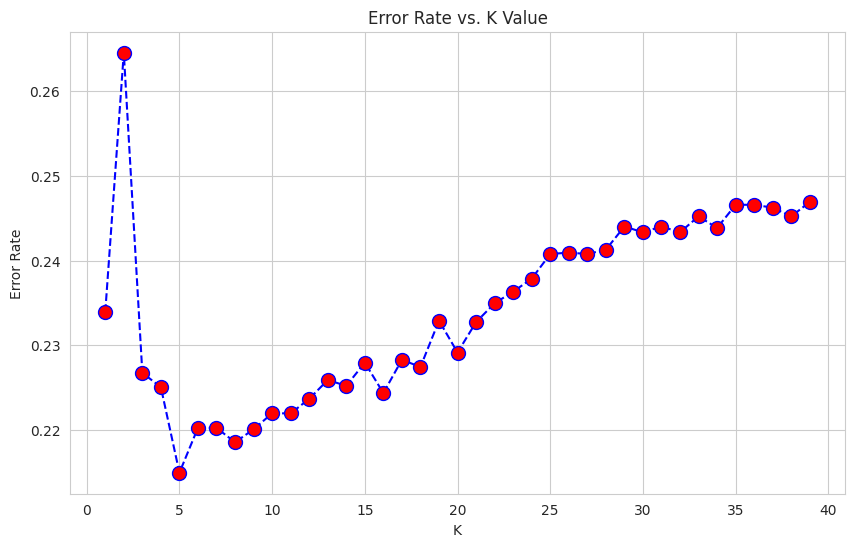

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue',linestyle='dashed',marker='o',markerfacecolor='red',markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')
plt.show()


In [ ]:
knn = KNeighborsClassifier(n_neighbors=30)
knn.fit(X_train,y_train)
pred = knn.predict(X_test)
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

[[   0   47    2    0    0    0    0    0    0    0    0]
 [   0  442  261    0    0    0    0    0    0    0    0]
 [   0   26 2427  203    0    0    0    0    0    0    0]
 [   0    3  356 1533    0    0    0    0    0    0    0]
 [   0    0    8  434   23    0    0    0    0    0    0]
 [   0    0    2   34   34    0    0    0    0    0    0]
 [   0    0    0    0    5    0    0    0    0    0    0]
 [   0    0    0    0    3    2    0    0    0    0    0]
 [   0    0    0    0    1    0    0    0    0    0    0]
 [   0    0    0    0    0    1    0    0    0    0    0]
 [   0    0    0    0    1    0    0    0    0    0    0]]


              precision    recall  f1-score   support

           1       0.00      0.00      0.00        49
           2       0.85      0.63      0.72       703
           3       0.79      0.91      0.85      2656
           4       0.70      0.81      0.75      1892
           5       0.34      0.05      0.09       465
           6       0.00      0.00 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Tree Methods

In [ ]:
import datetime

In [ ]:
house_pre_src['number of bathrooms'] = house_pre_src['number of bathrooms'].apply(math.ceil)
house_pre_src['number of bedrooms'] = house_pre_src['number of bedrooms'].apply(math.ceil)
house_pre_src['number of floors'] = house_pre_src['number of floors'].apply(math.ceil)
house_pre_src['waterfront present'] = house_pre_src['waterfront present'].replace(0, 1)
house_pre_src['number of views'] = house_pre_src['number of views'].replace(0, 1)
house_pre_src['Area of the basement'] = house_pre_src['Area of the basement'].replace(0, 1)
house_pre_src['Renovation Year'] = house_pre_src['Renovation Year'].replace(0, 1)
house_pre_src['Age of Building'] = datetime.datetime.now().year - house_pre_src['Built Year']
house_pre_src['Old or New'] = house_pre_src['Built Year'].apply(lambda x: 'New' if x > 2000 else 'Old')

In [ ]:
house_pre_src.head(5)


,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price,Area,Age of Building,Old or New
0,6762810635,42491,4,3,2920,4000,2,1,1,5,...,52.8878,-114.470,2470,4000,2,51,1400000,Sector_18,115,Old
1,6762810998,42491,5,3,2910,9480,2,1,1,3,...,52.8852,-114.468,2940,6600,1,53,1200000,Sector_18,85,Old
2,6762812605,42491,4,3,3310,42998,2,1,1,3,...,52.9532,-114.321,3350,42847,3,76,838000,Sector_22,23,New
3,6762812919,42491,3,2,2710,4500,2,1,1,4,...,52.9047,-114.485,2060,4500,1,51,805000,Sector_23,95,Old
4,6762813105,42491,3,3,2600,4750,1,1,1,4,...,52.9133,-114.590,2380,4750,1,67,790000,Sector_40,73,Old


In [ ]:
house_pre_src_tree = house_pre_src[['Old or New','Age of Building','number of floors','number of bedrooms']].copy()

In [ ]:
house_pre_src_tree.head(5)

,Old or New,Age of Building,number of floors,number of bedrooms
0,Old,115,2,4
1,Old,85,2,5
2,New,23,2,4
3,Old,95,2,3
4,Old,73,1,3


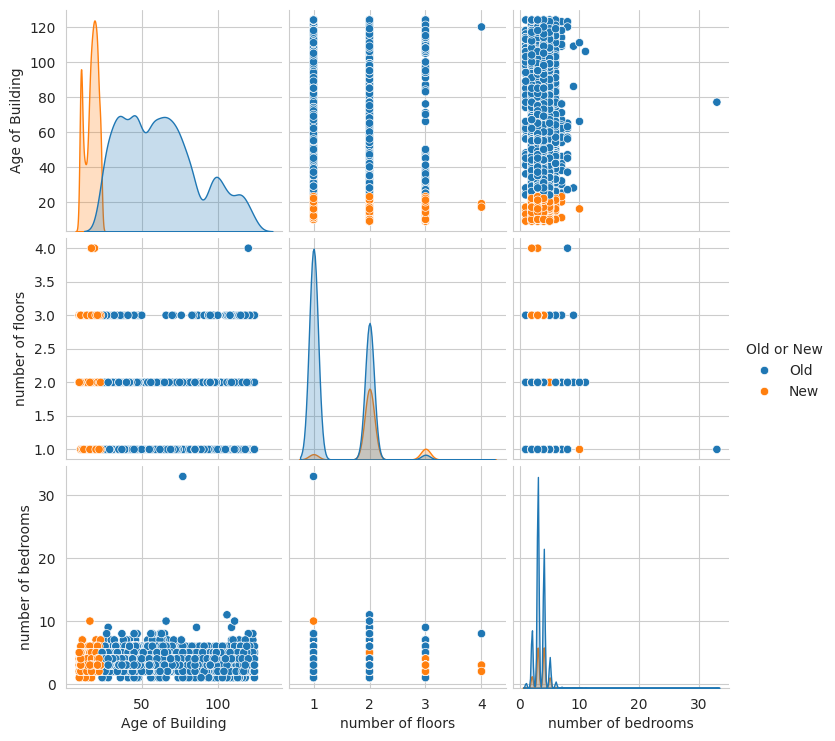

In [ ]:
sns.pairplot(house_pre_src_tree,hue='Old or New')

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X= house_pre_src_tree.drop('Old or New',axis=1)

In [ ]:
y= house_pre_src_tree['Old or New']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
dtree= DecisionTreeClassifier()

In [ ]:
dtree.fit(X_train,y_train)

DecisionTreeClassifier()

In [ ]:
predictions=dtree.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
print(classification_report(y_test,predictions))
print('\n')
print(confusion_matrix(y_test,predictions))

              precision    recall  f1-score   support

         New       1.00      1.00      1.00      1245
         Old       1.00      1.00      1.00      4603

    accuracy                           1.00      5848
   macro avg       1.00      1.00      1.00      5848
weighted avg       1.00      1.00      1.00      5848



[[1245    0]
 [   0 4603]]


In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
rfc = RandomForestClassifier(n_estimators=200)

In [ ]:
rfc.fit(X_train,y_train)

RandomForestClassifier(n_estimators=200)

In [ ]:
rfc_pred= rfc.predict(X_test)

In [ ]:
print(classification_report(y_test,rfc_pred))
print('\n')
print(confusion_matrix(y_test,rfc_pred))

              precision    recall  f1-score   support

         New       1.00      1.00      1.00      1245
         Old       1.00      1.00      1.00      4603

    accuracy                           1.00      5848
   macro avg       1.00      1.00      1.00      5848
weighted avg       1.00      1.00      1.00      5848



[[1245    0]
 [   0 4603]]


Support Vector Machine

In [ ]:
house_pre_src_svm = house_pre_src[['number of bedrooms',
'number of bathrooms',
'living area',
'lot area',
'number of floors',
'waterfront present',
'number of views',
'condition of the house',
'grade of the house',
'Area of the house(excluding basement)',
'Area of the basement',
'Built Year',
'Renovation Year',
'Lattitude',
'Longitude',
'living_area_renov',
'lot_area_renov']].copy()

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X= house_pre_src_svm
y= house_pre_src_svm['number of bedrooms']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.4,random_state=101)

In [ ]:
from sklearn.svm import SVC

In [ ]:
model = SVC()

In [ ]:
model.fit(X_train,y_train)

SVC()

In [ ]:
predictions = model.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
print(classification_report(y_test,predictions))
print('\n')
print(confusion_matrix(y_test,predictions))

              precision    recall  f1-score   support

           1       0.00      0.00      0.00        49
           2       0.00      0.00      0.00       703
           3       0.53      0.88      0.66      2656
           4       0.55      0.43      0.48      1892
           5       0.00      0.00      0.00       465
           6       0.00      0.00      0.00        70
           7       0.00      0.00      0.00         5
           8       0.00      0.00      0.00         5
           9       0.00      0.00      0.00         1
          10       0.00      0.00      0.00         1
          11       0.00      0.00      0.00         1

    accuracy                           0.54      5848
   macro avg       0.10      0.12      0.10      5848
weighted avg       0.42      0.54      0.46      5848



[[   0    0   49    0    0    0    0    0    0    0    0]
 [   0    0  685   18    0    0    0    0    0    0    0]
 [   0    0 2332  324    0    0    0    0    0    0    0]
 [   0    1

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
param_grid = {'C':[0.1,1,10,100,1000],'gamma':[1,0.1,0.01,0.001,0.0001]}

In [ ]:
grid = GridSearchCV(SVC(),param_grid,verbose=3)

In [ ]:
grid.fit(X_train,y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:737: UserWarning:

The least populated class in y has only 1 members, which is less than n_splits=5.



Fitting 5 folds for each of 25 candidates, totalling 125 fits
[CV 1/5] END ....................C=0.1, gamma=1;, score=0.451 total time=  11.5s
[CV 2/5] END ....................C=0.1, gamma=1;, score=0.451 total time=   7.8s
[CV 3/5] END ....................C=0.1, gamma=1;, score=0.451 total time=   9.4s
[CV 4/5] END ....................C=0.1, gamma=1;, score=0.451 total time=   7.5s
[CV 5/5] END ....................C=0.1, gamma=1;, score=0.451 total time=   9.5s
[CV 1/5] END ..................C=0.1, gamma=0.1;, score=0.451 total time=   9.5s
[CV 2/5] END ..................C=0.1, gamma=0.1;, score=0.451 total time=   7.6s
[CV 3/5] END ..................C=0.1, gamma=0.1;, score=0.451 total time=   9.4s
[CV 4/5] END ..................C=0.1, gamma=0.1;, score=0.451 total time=   8.2s
[CV 5/5] END ..................C=0.1, gamma=0.1;, score=0.451 total time=   8.7s
[CV 1/5] END .................C=0.1, gamma=0.01;, score=0.451 total time=   9.5s
[CV 2/5] END .................C=0.1, gamma=0.01

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001]},
             verbose=3)

In [ ]:
grid.best_params_

{'C': 10, 'gamma': 0.0001}

In [ ]:
grid.best_estimator_

SVC(C=10, gamma=0.0001)

In [ ]:
grid_predictions = grid.predict(X_test)

In [ ]:
print(classification_report(y_test,grid_predictions))
print('\n')
print(confusion_matrix(y_test,grid_predictions))

              precision    recall  f1-score   support

           1       1.00      0.04      0.08        49
           2       0.68      0.08      0.14       703
           3       0.46      0.97      0.62      2656
           4       0.53      0.03      0.07      1892
           5       0.00      0.00      0.00       465
           6       0.00      0.00      0.00        70
           7       0.00      0.00      0.00         5
           8       0.00      0.00      0.00         5
           9       0.00      0.00      0.00         1
          10       0.00      0.00      0.00         1
          11       0.00      0.00      0.00         1

    accuracy                           0.46      5848
   macro avg       0.24      0.10      0.08      5848
weighted avg       0.47      0.46      0.32      5848



[[   2    2   45    0    0    0    0    0    0    0    0]
 [   0   53  647    3    0    0    0    0    0    0    0]
 [   0   19 2586   50    1    0    0    0    0    0    0]
 [   0    3

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



K Means Clustering

Used to create artificial data
K-means clustering is an unsupervised machine learning algorithm used to group unlabeled data into distinct clusters. It's a popular technique for data exploration, pattern recognition, and customer segmentation.

How K-means works:

Initialization:

Choose a value for k, the number of desired clusters.
Randomly initialize k cluster centroids (points in the data space).
Assignment:

Assign each data point to the nearest centroid based on a distance metric (usually Euclidean distance).
Update Centroids:

Recalculate the centroids as the mean of all data points assigned to each cluster.
Repeat:

Iterate steps 2 and 3 until the centroids converge or a maximum number of iterations is reached.
Key points:

K-means is a greedy algorithm that may not find the global optimum solution.
The choice of k is crucial and can impact the quality of the clustering.
K-means is sensitive to the initialization of centroids. Different initializations can lead to different results.
Applications:

Customer segmentation
Image segmentation
Anomaly detection
Market research
Gene expression analysis
Advantages:

Simple to understand and implement.
Efficient for large datasets.
Scalable to handle large datasets.
Disadvantages:

Sensitive to the choice of k.
Prone to local optima.
Assumes spherical clusters.
Additional considerations:

Normalization: It's often necessary to normalize the data before applying K-means to ensure that features with different scales have equal influence.
Initialization methods: Different initialization methods (e.g., random, K-means++) can affect the quality of the clustering.
Evaluation metrics: To evaluate the quality of the clustering, you can use metrics like silhouette coefficient, Davies-Bouldin index, or Calinski-Harabasz index.
By understanding the K-means algorithm and its limitations, you can effectively apply it to various clustering problems in machine learning.

In [ ]:
from sklearn.datasets import make_blobs

In [ ]:
data = make_blobs(n_samples=200, n_features=2,centers=4,cluster_std=1.8,random_state=101)

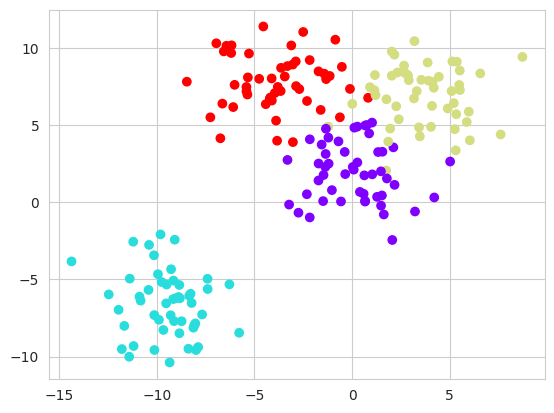

In [ ]:
plt.scatter(data[0][:,0],data[0][:,1],c=data[1],cmap='rainbow')

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=4)

In [ ]:
kmeans.fit(data[0])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



KMeans(n_clusters=4)

In [ ]:
kmeans.cluster_centers_

array([[ 3.71749226,  7.01388735],
       [-9.46941837, -6.56081545],
       [-0.0123077 ,  2.13407664],
       [-4.13591321,  7.95389851]])

In [ ]:
kmeans.labels_

array([3, 0, 2, 0, 0, 1, 0, 2, 0, 2, 3, 2, 0, 0, 3, 2, 0, 2, 1, 3, 1, 2,
       2, 1, 3, 1, 1, 2, 0, 0, 3, 1, 0, 2, 2, 3, 1, 1, 1, 2, 1, 3, 3, 3,
       2, 0, 3, 2, 1, 2, 2, 3, 0, 2, 1, 3, 2, 2, 3, 0, 1, 0, 1, 3, 0, 2,
       1, 0, 0, 1, 0, 2, 1, 2, 1, 0, 0, 2, 3, 2, 2, 1, 0, 1, 2, 2, 2, 3,
       2, 1, 1, 1, 1, 2, 2, 1, 0, 3, 1, 0, 2, 1, 2, 2, 0, 2, 1, 0, 1, 1,
       0, 3, 3, 0, 1, 0, 3, 3, 0, 3, 2, 3, 2, 3, 2, 0, 3, 2, 1, 3, 3, 3,
       2, 1, 1, 3, 0, 3, 0, 2, 1, 0, 1, 3, 3, 0, 2, 1, 3, 3, 3, 3, 2, 0,
       2, 3, 0, 0, 0, 2, 0, 2, 2, 3, 1, 3, 2, 0, 3, 2, 0, 2, 3, 0, 2, 3,
       0, 0, 1, 0, 3, 1, 1, 3, 1, 1, 1, 1, 1, 2, 1, 0, 0, 3, 1, 2, 0, 0,
       1, 2], dtype=int32)

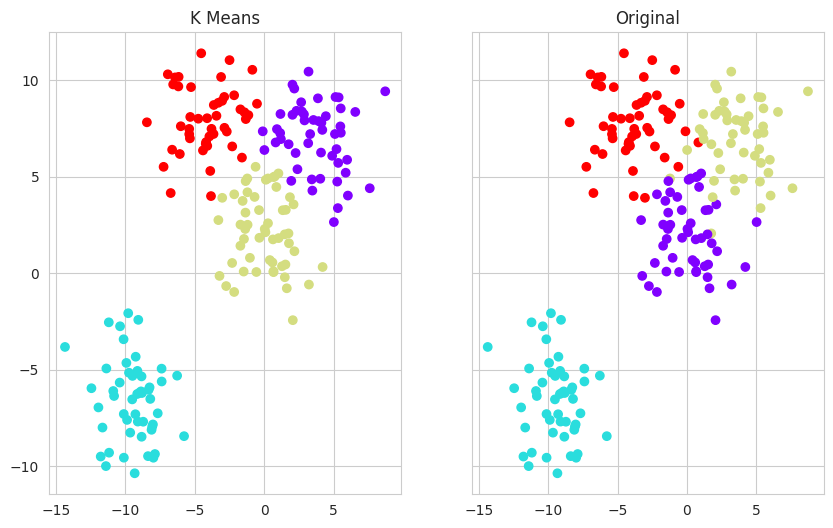

In [ ]:
fig,(ax1,ax2)=plt.subplots(1,2,sharey=True,figsize=(10,6))
ax1.set_title('K Means')
ax1.scatter(data[0][:,0],data[0][:,1],c=kmeans.labels_,cmap='rainbow')
ax2.set_title('Original')
ax2.scatter(data[0][:,0],data[0][:,1],c=data[1],cmap='rainbow')

Principle Component Analysis(PCA)

In [ ]:
house_pre_src['number of bathrooms'] = house_pre_src['number of bathrooms'].apply(math.ceil)
house_pre_src['number of bedrooms'] = house_pre_src['number of bedrooms'].apply(math.ceil)
house_pre_src['number of floors'] = house_pre_src['number of floors'].apply(math.ceil)
house_pre_src['waterfront present'] = house_pre_src['waterfront present'].replace(0, 1)
house_pre_src['number of views'] = house_pre_src['number of views'].replace(0, 1)
house_pre_src['Area of the basement'] = house_pre_src['Area of the basement'].replace(0, 1)
house_pre_src['Renovation Year'] = house_pre_src['Renovation Year'].replace(0, 1)
house_pre_src['Age of Building'] = datetime.datetime.now().year - house_pre_src['Built Year']
house_pre_src['Old or New'] = house_pre_src['Built Year'].apply(lambda x: 'New' if x > 2000 else 'Old')
house_pre_src_pca = house_pre_src.copy().drop('Area',axis=1).drop('Old or New',axis=1)

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler()

In [ ]:
scaler.fit(house_pre_src_pca)


StandardScaler()

In [ ]:
scaled_data =scaler.transform(house_pre_src_pca)

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components=2)

In [ ]:
pca.fit(scaled_data)

PCA(n_components=2)

In [ ]:
x_pca = pca.transform(scaled_data)

In [ ]:
scaled_data.shape

(14619, 24)

In [ ]:
x_pca.shape

(14619, 2)

Text(0, 0.5, 'Second principal component')

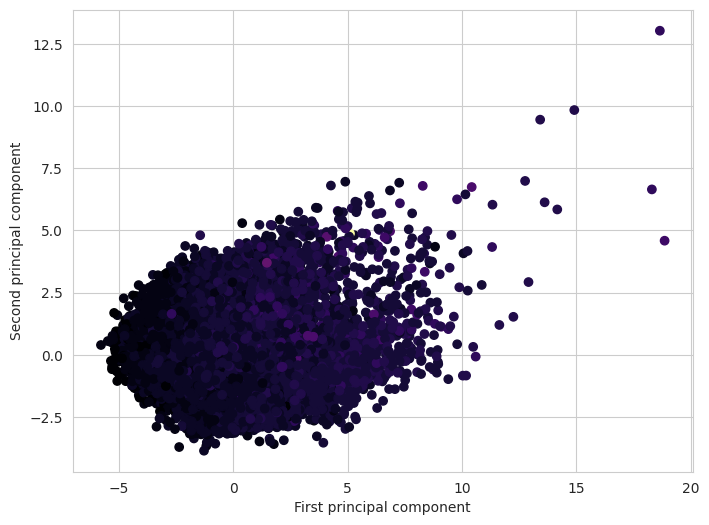

In [ ]:
plt.figure(figsize=(8,6))
plt.scatter(x_pca[:,0],x_pca[:,1],c=house_pre_src_pca['number of bedrooms'],cmap='inferno')
plt.xlabel('First principal component')
plt.ylabel('Second principal component')

In [ ]:
pca.components_

array([[-2.90698587e-01, -1.46313981e-02,  2.13050516e-01,
         3.27208156e-01,  3.62054290e-01,  7.75327488e-02,
         1.99326977e-01,  2.08316967e-23,  1.13255865e-01,
        -7.30637696e-02,  3.48418948e-01,  3.52628180e-01,
         9.38353955e-02,  2.10977372e-01,  6.80981207e-03,
        -7.14971368e-02,  4.87997451e-02,  1.40163885e-01,
         3.25688637e-01,  8.17355810e-02,  1.86654735e-04,
         1.23163896e-03,  2.90382848e-01, -2.10977372e-01],
       [-2.74943092e-01, -1.90508936e-02,  7.90926369e-02,
        -5.47081870e-02,  1.15186213e-01, -4.57792132e-02,
        -1.43616961e-01, -5.15148155e-21,  2.17335149e-01,
         2.69624590e-01,  2.26346295e-02, -4.99624568e-02,
         3.31202690e-01, -4.40115252e-01,  1.85780079e-01,
        -4.95279576e-02,  2.47055312e-01, -2.71315810e-01,
         4.22856001e-02, -5.93661424e-02,  1.08294246e-02,
         3.15766250e-03,  2.85851596e-01,  4.40115252e-01]])

In [ ]:
heat_comp = pd.DataFrame(pca.components_,columns=house_pre_src_pca.columns)

In [ ]:
heat_comp

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Renovation Year,Postal Code,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price,Age of Building
0,-0.290699,-0.014631,0.213051,0.327208,0.362054,0.077533,0.199327,2.083170e-23,0.113256,-0.073064,...,0.00681,-0.071497,0.048800,0.140164,0.325689,0.081736,0.000187,0.001232,0.290383,-0.210977
1,-0.274943,-0.019051,0.079093,-0.054708,0.115186,-0.045779,-0.143617,-5.151482e-21,0.217335,0.269625,...,0.18578,-0.049528,0.247055,-0.271316,0.042286,-0.059366,0.010829,0.003158,0.285852,0.440115


<Axes: >

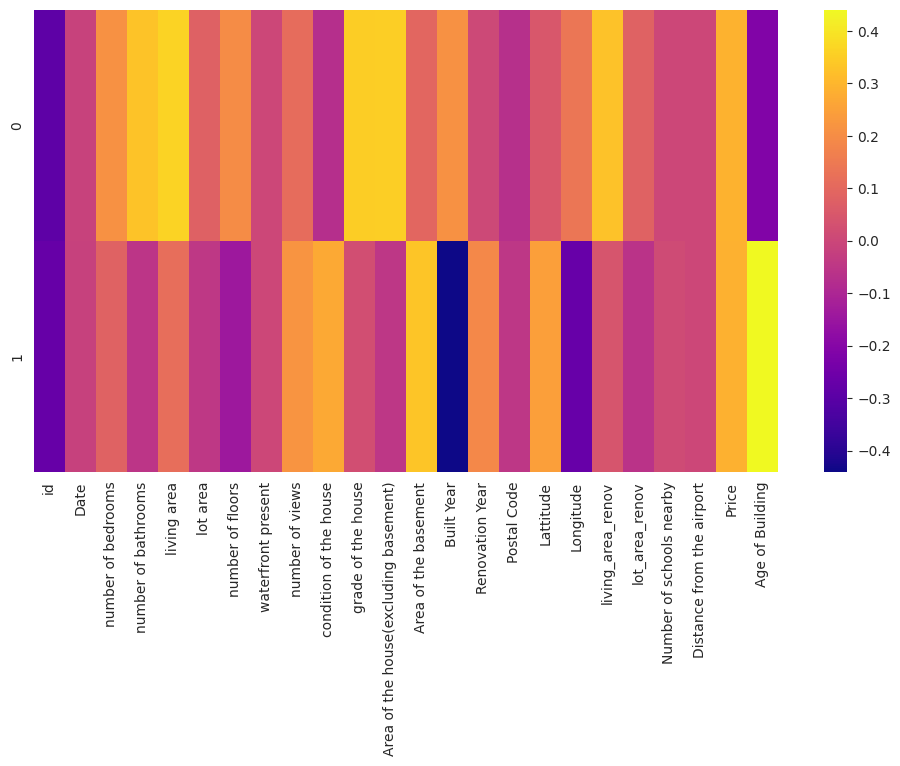

In [ ]:
plt.figure(figsize=(12,6))
sns.heatmap(heat_comp,cmap='plasma')

Recommender System

In [ ]:
house_pre_src.keys()

Index(['id', 'Date', 'number of bedrooms', 'number of bathrooms',
       'living area', 'lot area', 'number of floors', 'waterfront present',
       'number of views', 'condition of the house', 'grade of the house',
       'Area of the house(excluding basement)', 'Area of the basement',
       'Built Year', 'Renovation Year', 'Postal Code', 'Lattitude',
       'Longitude', 'living_area_renov', 'lot_area_renov',
       'Number of schools nearby', 'Distance from the airport', 'Price',
       'Area', 'Age of Building', 'Old or New'],
      dtype='object')

In [ ]:
house_pre_src['House Rating'] = house_pre_src['condition of the house']

In [ ]:
house_pre_src_rs = house_pre_src[['id','Date','House Rating','Price','Area']]

In [ ]:
sns.set_style('whitegrid')

In [ ]:
house_pre_src_rs.groupby('Area')['House Rating'].mean().sort_values(ascending = False).head()

,House Rating
Area,
Sector_82,3.775510
Sector_97,3.765152
Sector_93,3.740260
Sector_74,3.720339
Sector_94,3.707865


In [ ]:
house_pre_src_rs.groupby('Area')['House Rating'].count().sort_values(ascending = False).head()

,House Rating
Area,
Sector_49,432
Sector_22,416
Sector_23,397
Sector_40,396
Sector_35,383


In [ ]:
ratings = pd.DataFrame(house_pre_src_rs.groupby('Area')['House Rating'].mean())

In [ ]:
ratings['Number of ratings'] = pd.DataFrame(house_pre_src_rs.groupby('Area')['House Rating'].count())

In [ ]:
ratings.head()

,House Rating,Number of ratings
Area,,
Civil Lines,3.434109,129
DLF_Phase_1,3.035354,198
Palam_Vihar,3.428571,77
Sector_14,3.301136,176
Sector_15,3.243802,242


<Axes: >

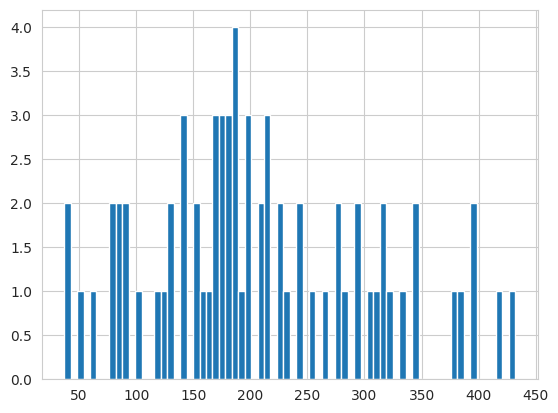

In [ ]:
ratings['Number of ratings'].hist(bins=70)

<Axes: >

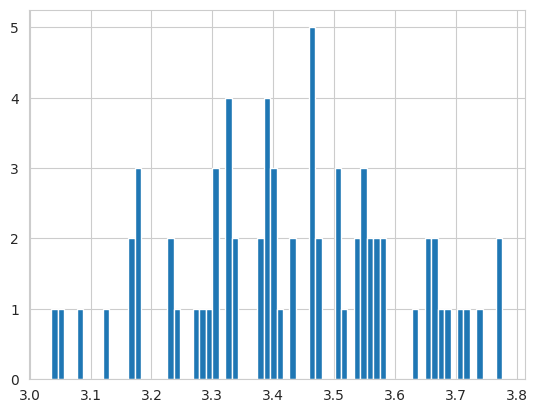

In [ ]:
ratings['House Rating'].hist(bins=70)

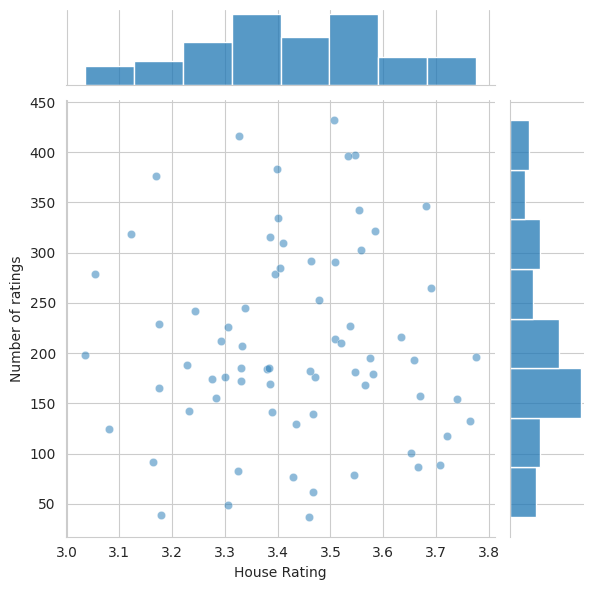

In [ ]:
sns.jointplot(x='House Rating',y='Number of ratings',data=ratings,alpha=0.5)

Natural Language Processing

In [ ]:
pip install nltk

In [ ]:
house_pre_src

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price,Area,Age of Building,Old or New,House Rating
0,6762810635,42491,4,3,2920,4000,2,1,1,5,...,-114.470,2470,4000,2,51,1400000,Sector_18,115,Old,5
1,6762810998,42491,5,3,2910,9480,2,1,1,3,...,-114.468,2940,6600,1,53,1200000,Sector_18,85,Old,3
2,6762812605,42491,4,3,3310,42998,2,1,1,3,...,-114.321,3350,42847,3,76,838000,Sector_22,23,New,3
3,6762812919,42491,3,2,2710,4500,2,1,1,4,...,-114.485,2060,4500,1,51,805000,Sector_23,95,Old,4
4,6762813105,42491,3,3,2600,4750,1,1,1,4,...,-114.590,2380,4750,1,67,790000,Sector_40,73,Old,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14614,6762830250,42734,2,2,1556,20000,1,1,1,4,...,-114.472,2250,17286,3,76,221700,Sector_91,67,Old,4
14615,6762830339,42734,3,2,1680,7000,2,1,1,4,...,-114.393,1540,7480,3,59,219200,Sector_97,56,Old,4
14616,6762830618,42734,2,1,1070,6120,1,1,1,3,...,-114.507,1130,6120,2,64,209000,Sector_81,62,Old,3
14617,6762830709,42734,4,1,1030,6621,1,1,1,4,...,-114.411,1420,6631,3,54,205000,Sector_67,69,Old,4


In [ ]:
house_pre_src['Overall comments'] = house_pre_src['grade of the house'].apply(lambda x: 'Negative' if 1 <= x <= 4 else ('Neutral' if 5 <= x <= 7 else 'Positive'))

In [ ]:
column_data = house_pre_src['id']

# Print the column data
print(column_data)
column_data.to_csv('E:\House Price\column_data.csv', index=False)

0        6762810635
1        6762810998
2        6762812605
3        6762812919
4        6762813105
            ...    
14614    6762830250
14615    6762830339
14616    6762830618
14617    6762830709
14618    6762831463
Name: id, Length: 14619, dtype: int64


In [ ]:
import nltk

In [ ]:
nltk.download_shell()

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> d

Download which package (l=list; x=cancel)?
  Identifier> stopwords


      Unzipping corpora/stopwords.zip.



---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> q


In [ ]:
spam_mail = pd.read_csv('spam_mail.csv', encoding='latin-1')  # Try different encodings here

In [ ]:
merged_df = pd.merge(house_pre_src, spam_mail, left_on='id', right_on='customer_spamid')

In [ ]:
spammer_name = merged_df['Spammer_Name'].describe()
print(spammer_name)

count     14619
unique        2
top         ham
freq      12659
Name: Spammer_Name, dtype: object


In [ ]:
Spam_mail= merged_df['Spam_mail'].describe()
print(Spam_mail)

count                      14619
unique                      5168
top       Sorry, I'll call later
freq                          81
Name: Spam_mail, dtype: object


In [ ]:
house_pre_src_nlp = merged_df.copy()

In [ ]:
house_pre_src_nlp['length of message'] = house_pre_src_nlp['Spam_mail'].apply(len)

<Axes: ylabel='Frequency'>

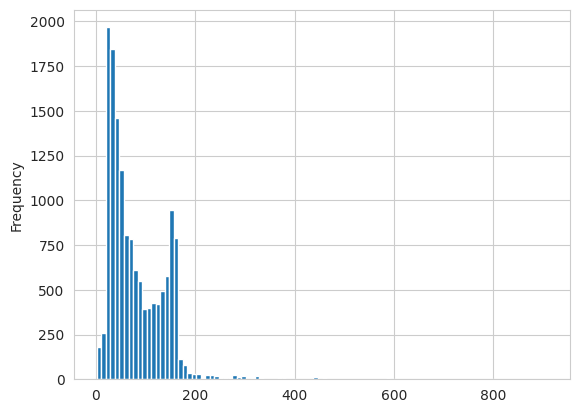

In [ ]:
house_pre_src_nlp['length of message'].plot.hist(bins=100)

In [ ]:
import string

In [ ]:
from nltk.corpus import stopwords


In [ ]:
stopwords.words('english')

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [ ]:
def text_process(mess):
  nopunc = [char for char in mess if char not in string.punctuation]
  nopunc = ''.join(nopunc)
  return [word for word in nopunc.split() if word.lower() not in stopwords.words('english')]

In [ ]:
house_pre_src_nlp['Spam_mail'].head(5)

,Spam_mail
0,"Go until jurong point, crazy.. Available only ..."
1,Ok lar... Joking wif u oni...
2,Free entry in 2 a wkly comp to win FA Cup fina...
3,U dun say so early hor... U c already then say...
4,"Nah I don't think he goes to usf, he lives aro..."


In [ ]:
house_pre_src_nlp['Spam_mail'].head(5).apply(text_process)

,Spam_mail
0,"[Go, jurong, point, crazy, Available, bugis, n..."
1,"[Ok, lar, Joking, wif, u, oni]"
2,"[Free, entry, 2, wkly, comp, win, FA, Cup, fin..."
3,"[U, dun, say, early, hor, U, c, already, say]"
4,"[Nah, dont, think, goes, usf, lives, around, t..."


applying vectorization in NLP model

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
bow_transformer = CountVectorizer(analyzer=text_process).fit(house_pre_src_nlp['Spam_mail'])

In [ ]:
print(len(bow_transformer.vocabulary_))

11418


In [ ]:
mess4 = house_pre_src_nlp['Spam_mail'][3]
print(mess4)

U dun say so early hor... U c already then say...


In [ ]:
bow= bow_transformer.transform([mess4])

In [ ]:
print(bow.shape)

(1, 11418)


In [ ]:
print(bow)

  (0, 4068)	2
  (0, 4629)	1
  (0, 5261)	1
  (0, 6204)	1
  (0, 6222)	1
  (0, 7185)	1
  (0, 9551)	2


In [ ]:
feature_name = list(bow_transformer.vocabulary_.keys())[9551]
print(feature_name)

087143423992stop


In [ ]:
spammail_bow = bow_transformer.transform(house_pre_src_nlp['Spam_mail'])

In [ ]:
print('Shape of Sparse Matrix: ',spammail_bow.shape)
print('\n')
print('Amount of Non-Zero occurences: ',spammail_bow.nnz)

Shape of Sparse Matrix:  (14619, 11418)


Amount of Non-Zero occurences:  132646


In [ ]:
sparsity = (100.0 * spammail_bow.nnz/(spammail_bow.shape[0]*spammail_bow.shape[1]))
print('sparsity: {}'.format(sparsity))

sparsity: 0.07946693327623283


In [ ]:
from sklearn.feature_extraction.text import TfidfTransformer

In [ ]:
tfidf_transformer = TfidfTransformer().fit(spammail_bow)

In [ ]:
tfidf4 = tfidf_transformer.transform(bow)

the output gives inverse document frequency(IDF) and term frequency(TF)

In [ ]:
print(tfidf4)

  (0, 9551)	0.535567584717335
  (0, 7185)	0.4505892563203994
  (0, 6222)	0.31543596299506277
  (0, 6204)	0.3007029827425327
  (0, 5261)	0.2930704659646098
  (0, 4629)	0.2642985896779438
  (0, 4068)	0.40554964083491374


In [ ]:
from sklearn.naive_bayes import MultinomialNB

In [ ]:
spam_detect_model = MultinomialNB().fit(spammail_bow,house_pre_src_nlp['Spammer_Name'])

for individual

In [ ]:
spam_detect_model.predict(tfidf4)[0]

'ham'

For all

In [ ]:
all_pred = spam_detect_model.predict(spammail_bow)

In [ ]:
all_pred

array(['ham', 'ham', 'spam', ..., 'ham', 'ham', 'ham'], dtype='<U4')

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
msg_train,msg_test,label_train,label_test = train_test_split(house_pre_src_nlp['Spam_mail'],house_pre_src_nlp['Spammer_Name'],test_size=0.3)

In [ ]:
from sklearn.pipeline import Pipeline

In [ ]:
pipeline = Pipeline([('bow',CountVectorizer(analyzer=text_process)),('tfidf',TfidfTransformer()),('classifier',MultinomialNB())])

In [ ]:
pipeline.fit(msg_train,label_train)

Pipeline(steps=[('bow',
                 CountVectorizer(analyzer=<function text_process at 0x7da095b5dfc0>)),
                ('tfidf', TfidfTransformer()),
                ('classifier', MultinomialNB())])

In [ ]:
prediction= pipeline.predict(msg_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
print(classification_report(label_test,prediction))
print('\n')
print(confusion_matrix(label_test,prediction))

              precision    recall  f1-score   support

         ham       0.98      1.00      0.99      3784
        spam       1.00      0.90      0.95       602

    accuracy                           0.99      4386
   macro avg       0.99      0.95      0.97      4386
weighted avg       0.99      0.99      0.99      4386



[[3784    0]
 [  60  542]]
